In [1]:
!pip install librosa 

In [2]:
#Se importan las libreria que se utilizaran duarante toda la guía.
from scipy.io.wavfile import read 
from IPython.display import Audio
import matplotlib.pyplot as plt
import numpy as np
import pywt
import librosa
from scipy.signal import kaiserord, lfilter, firwin, freqz  
import scipy.signal as signal
import soundfile as sf

%matplotlib inline


from sklearn.preprocessing import normalize

 ### 1.2 Cargue la señal de audio (tambores.wav) adjunta en la carpeta. Grafique la señal de audio normalizada en el dominio del tiempo.

In [3]:
signal = 'tambores.wav'
audio=(signal) 

fs, x = read(audio)
x=x/float(max(abs(x)))
t=np.arange(0, float(len(x))/fs, 1.0/fs)

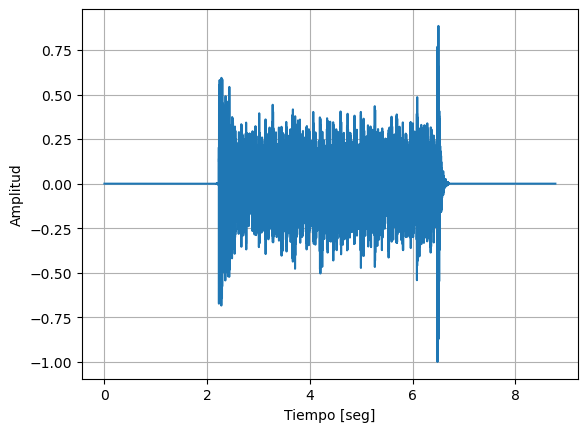

In [4]:
# Se procede a graficar la señal leida anteriormente
plt.plot(t,x) 
plt.xlabel('Tiempo [seg]')
plt.ylabel('Amplitud') 
plt.grid()
plt.show()

### 1.3 Identifique la frecuencia a la que se muestrea la señal

In [5]:
print(f'Esta es la frecuencia de muestreo de la señal: {fs}')

Esta es la frecuencia de muestreo de la señal: 8000


### 1.4 Escuche e identifique a que instrumento pertenece la señal presentada.

In [6]:
Audio(x, rate = fs) 

La señal de audio presentada anteriormente es de un instrumento de percusión, posiblemente un redoblante o tambor

# 2. Análisis en el dominio de la frecuencia.

## 2.1 Para la señal tratada en el numeral anterior, encuentre los coeficientes de la TDW.

In [7]:
audio, fs = librosa.load(signal) 

wavelet = 'db4' 

# Realizar la TDW de la señal de audio
coeffs = pywt.wavedec(audio, wavelet)


## 2.1 Grafique los coeficientes de la TDW, encontrados anteriormente.

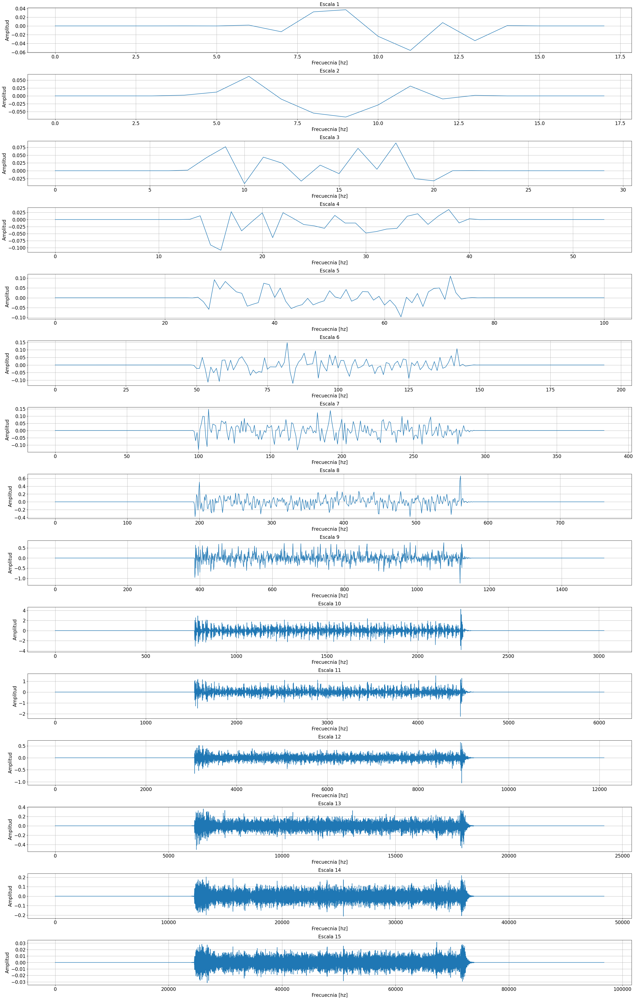

In [8]:
# Supongamos que tienes una lista de coeficientes llamada "coeffs"
# y una señal de audio original llamada "audio"
# y una frecuencia de muestreo "fs"

plt.figure(figsize=(30, 50))


for i in range(len(coeffs)):
    plt.subplot(len(coeffs) + 1, 1, i + 2)
    plt.plot(np.arange(len(coeffs[i])), coeffs[i])
    plt.title('Escala {}'.format(i + 1), size=16)
    plt.xlabel('Frecuecnia [hz]', fontsize=16)
    plt.ylabel('Amplitud', fontsize=16)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid()
    # Si deseas reproducir los coeficientes de la TDW en cada escala, puedes usar:
    # Audio(coeffs[i], rate=fs)

plt.tight_layout()
plt.show()

### 2.3 ¿Qué puede observar conforme se presenta una escala superior? ¿Como se comporta la señal de interés?


El objetivo de la TDW es descomponer la señal en multiples escalas o vistas. En el eje de las amplitudes (eje y) es posible observar la amplitud y sus dimensiones, para ciertos rangos de frecuencia.

A mayor es la escala analizada, el tamaño de paso de las frecuencias aunmenta, siendo asi posible analizar la señal de una manera más uniforme.

### 2.4 ¿En que rangos de frecuencia se logra tener mayor amplitud y menor amplitud?

Al observar la escala 14, es posible identificar una amplitud mayor con respecto a las demás escalas presentadas, las frecuencias oscilan entre 500hz y 1500hz. Ahora, se logra una menor amplitud en rangos de frecuecnia mayores, en la escala 18 se puede observar como de 2000 hz a 2500hz la amplitud es bastante baja.

### 2.5 ¿Qué ventajas encuentra en la TDW con respecto a la transformada de Fourier al momento de analizar el espectro de la señal? Realice la transformada discreta de Fourier del audio anterior, grafique sus componentes espectrales para un mejor análisis y concluya.

In [9]:
def calcular_dft_audio(file_path):
    
    # Se importa el audio.
    audio, sr = librosa.load(file_path, sr=None)
    
    # Calcular la DFT del audio
    dft = np.fft.fft(audio)
    
    # Calculo de los coeficientes de la DFT
    frecuencias = np.fft.fftfreq(len(audio), 1/sr)
    
    # Se normalizan los ejes
    magnitud_dft = np.abs(dft)
    magnitud_dft_normalizada = magnitud_dft / np.max(magnitud_dft)
    
    
    # Graficar la DFT normalizada
    plt.plot(frecuencias, magnitud_dft_normalizada)
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Magnitud')
    plt.title('Transformada Discreta de Fourier (DFT) ')
    plt.grid(True)
    plt.show()

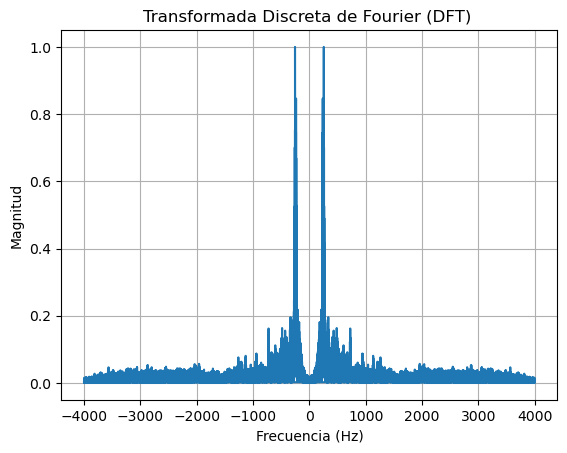

In [10]:
dft_siganl = calcular_dft_audio('tambores.wav')

Si bien ambas herramientas son de gran ayuda a la hora de analizar una señal en el dominio de la frecuencia, se encuentran ciertas particularidades, a partir del análisis de la gráficas anteriores, como los siguientes:

- Mayor nivel de detalle en el análisis de las componentes espectrales con la TDW. A escalas inferiores de la TDW es posible observar un nivel de detalle muy fino, en cuanto al comportamiento de la frecuencia se refiere.

- La DFT proporciona una representación más global y uniforme en el dominio de la frecuencia. Solo es posible observar una escala, para la visualización del rango de frecuencias.

- La TDW puede identificar y localizar eventos en una señal de audio con mayor precisión en comparación con la DFT. Esto es bastante útil a la hora de suprimir o identificar ruido en la señal.

- La información que presentan ambas transformadas se complementa, en ambas predominan las bajas frecuencias.



### 2.6 Basado en su experiencia, ¿son coherentes los resultados obtenidos anteriormente?

El audio presenta el sonido de un tambor o redoblante, en otras palabras, un instrumento de percusión. Estos instrumentos se caracterizan por alcanzar frecuencias bajas, en la mayoria de los casos.Pueden ir desde los 30hz hasta los 2000hz, por tanto, los anteriores espectros no estan alejados de la realidad.

# 3. Energia de la señal

## 3.1 Utilizando el siguiente bloque código, calcule la energía de la señal  analizada previamente con la TDW

In [11]:
def tdw_energy(coeffs):
    tdw_energy = 0
    for i in range(len(coeffs)):
        tdw_energy += np.sum(np.square(coeffs[i]))
        
    return tdw_energy

In [12]:
energy_signal_tdw = tdw_energy(coeffs);

In [13]:
print(f' La energia de la señal analizada con la TDW es de: {energy_signal_tdw}')

 La energia de la señal analizada con la TDW es de: 1384.346663649194


## 3.2 Utilizando la transformada de Fourier encuentre la energia de la señal anteriormente analizada con la TDW.

In [14]:
def fourier_energy(audio):
    dft = np.fft.fft(audio)
    energy = np.sum(np.square(np.abs(dft))) / len(dft)
    return energy

In [15]:
e_fourier = fourier_energy(audio)

In [16]:
print(f' La energia de la señal analizada con la Transformada de Fourier es de: {e_fourier}')

 La energia de la señal analizada con la Transformada de Fourier es de: 1384.3468704139943


## 3.3 Vuelva a cálcular la energia de la señal, esta vez utilizando el teorema de parseval

In [17]:
def energy(signal):
   
    return np.sum(signal**2)

In [18]:
energy_total = energy(audio)

In [19]:
print(f' La energia de la señal utilizando el teorema de Parseval es de: {energy_total}')

 La energia de la señal utilizando el teorema de Parseval es de: 1384.3470458984375


## 3.4	¿La energía de la señal cambio entre los diferentes métodos? Si es así, ¿por qué se da este hecho?

Hay una variación muy pequeña en el valor de la energia que se cálculo con la TDW, la trasnformada de Fourier y por el teorema de Parseval. Dicha variación, que aunque pequeña es, se puede atribuir a la manera en la que se cálcula la energia de la señal. 

Por el método de Fourier, por ejemplo calcula el valor absoluto de los coeficientes de la Transformada de Fourier, los eleva al cuadrado, y finalmente calcula la suma de los cuadrados de los valores absolutos y la divide por la longitud de la señal.

Por el método de la TDW, se divide la señal en diferentes escalas y frecuencias, es decir, en cada escala se toma el valor de la energia y dicho valor se lleva a una sumatoria, que será el valor de la energia total.

Por el teorema de Parseval, se eleva al cuadrado cada muestra de la señal y luego se suman los cuadrados de cada componente para obtener la energía total de la señal.

Sin embargo el valor de la energia entre un método y otro no varia mucho en su parte entera.

# 4. Transformada inversa de Wavelet

## 4.1 Utilizando el valor de los coeficientes encontrados anteriormente con la TDW, reconstruya la señal original en el dominio del tiempo.

In [20]:
mode = 'symmetric'

# Reconstruir la señal a partir de los coeficientes de TDW
reconstructed_signal = pywt.waverec(coeffs, wavelet, mode=mode)


In [21]:
Audio(reconstructed_signal, rate = fs) 

## 4.2 ¿Qué puede concluir acerca de la reconstrucción de la señal, percibe diferencias considerables con respecto a la señal original?

Aparentemente no se dieron cambios siginificativos en la resconstrucción de la señal, a partir de los coeficientes de la TDW, encontrados anteriormente. Sin embargo, es posible que se hayan dado cambios y sean percibidos solo por personas con gran sensibilidad en el oído.

Esto se debe a una propiedad de descomposición presente en la transformada.  Durante la descomposición, se obtienen coeficientes que representan la contribución de cada escala y frecuencia en la señal original. Sin embargo, a medida que se descompone la señal en escalas más altas, se va perdiendo información detallada y de alta frecuencia.

# 5. Filtros y la TDW

## 5.1 Tome la señal de audio 2, adjunta en la guía y observe con mucho detalle su comportamiento en frecuencia mediante la TDW.

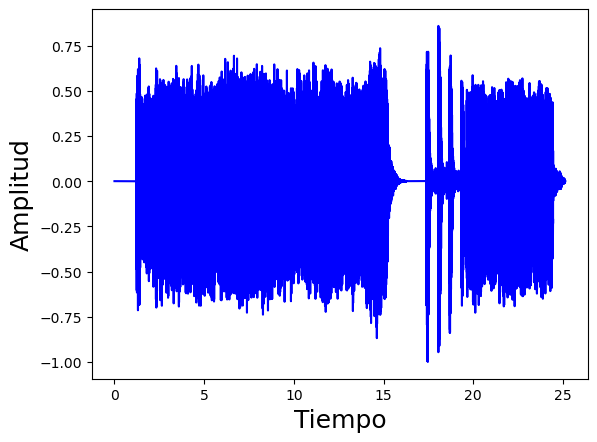

In [22]:
file_audio=('Guitarra.wav') # Ruta del archivo con la senal
fs, x=read(file_audio) # Cargar el archivo
x=x/float(max(abs(x))) # escala la amplitud de la senal
t=np.arange(0, float(len(x))/fs, 1.0/fs) 
plt.plot(t,x, color='blue') 
plt.xlabel('Tiempo',fontsize=18) 
plt.ylabel('Amplitud',fontsize=18) 

plt.show() # Mostrar la grafica
Audio(x, rate=fs) # para escuchar la senal, si se desea

In [23]:
audio, fs = librosa.load("Guitarra.wav")

wavelet = 'db4'

# Realizar la TDW de la señal de audio
coeffs = pywt.wavedec(audio, wavelet) 

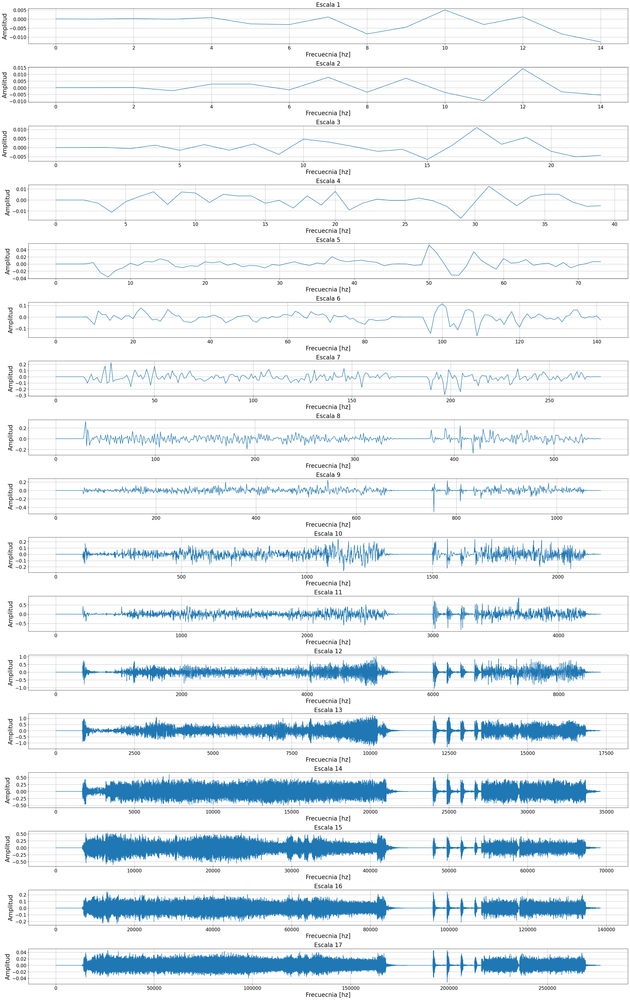

In [24]:
# Supongamos que tienes una lista de coeficientes llamada "coeffs"
# y una señal de audio original llamada "audio"
# y una frecuencia de muestreo "fs"

plt.figure(figsize=(30, 50))


for i in range(len(coeffs)):
    plt.subplot(len(coeffs) + 1, 1, i + 2)
    plt.plot(np.arange(len(coeffs[i])), coeffs[i])
    plt.title('Escala {}'.format(i + 1), size=20)
    plt.xlabel('Frecuecnia [hz]', fontsize=20)
    plt.ylabel('Amplitud', fontsize=20)
    
    # Normalizar ejes
    plt.axis('tight')
    
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    
    plt.grid()
    # Si deseas reproducir los coeficientes de la TDW en cada escala, puedes usar:
    # Audio(coeffs[i], rate=fs)

plt.tight_layout()
plt.show()

El audio 2 de la guía es de una guitarra eléctrica. Las frecuecnias a las que puede llegar dicho instrumento son variadas, sin embargo, por el comportamineto de los coeficientes de la TDW, y basados en la experiencia de laboratorios anteriores, es posible concluir que las mayores amplitudes se dan en rangos de frecuencia a partir de 2Khz. En las últimas escalas se presentan frecuencias de por ejemplo 50 Khz, sin embargo estas no alcanzan a tomar amplitudes considerables. Estos rangos de frecuencias prodrían ser equivalentes a ruido presente en el ambiente. Lo mismo aplica para frecuencias especialmente bajas.

## 5.2	Diseñe un filtro FIR pasa-bajas con la banda de transición de 200, frecuencia de corte de 2000Hz y un ripple de 60 dB

In [35]:
import scipy.signal as signal
from scipy.signal import kaiserord, lfilter, firwin, freqz
nyq_rate = fs / 2.0
roll_off = 200
cutoff_hz = 200
width = roll_off/nyq_rate
ripple_db = 60
N,_= kaiserord(ripple_db, width) 
taps = firwin(N, cutoff_hz/nyq_rate, pass_zero=True)
w, h = signal.freqz(taps, [1], worN=2000)

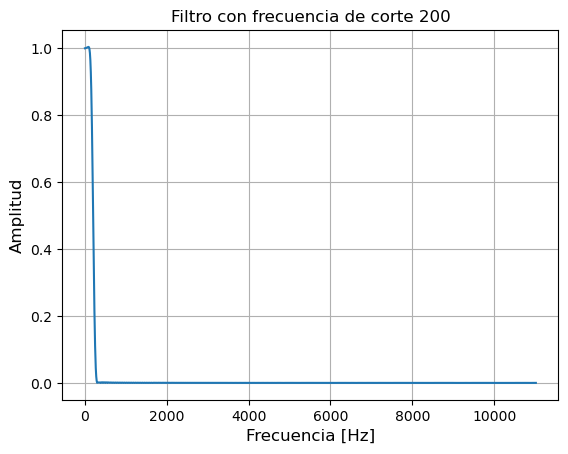

In [36]:
plt.plot(nyq_rate*w/np.pi, np.abs(h))
plt.xlabel('Frecuencia [Hz]',fontsize=12)
plt.ylabel('Amplitud',fontsize= 12)
plt.title(f'Filtro con frecuencia de corte {cutoff_hz}')
plt.grid()

In [37]:
filtered_x = lfilter(taps, 1.0, x)

In [28]:
Audio(filtered_x, rate=fs)

## 5.3 Que puede percibir en el audio al variar la frecuencia de corte a 100 Hz, 1000Hz y a 10000Hz

In [29]:
nyq_rate = fs / 2.0
roll_off = 200
cutoff_hz = 100
width = roll_off/nyq_rate
ripple_db = 60 
N,_= kaiserord(ripple_db, width) 
taps = firwin(N, cutoff_hz/nyq_rate, pass_zero=True)
w, h = signal.freqz(taps, [1], worN=2000)

filtered_x_100 = lfilter(taps, 1.0, x)

Audio(filtered_x_100, rate=fs)

In [30]:
nyq_rate = fs / 2.0
roll_off = 200
cutoff_hz = 1000
width = roll_off/nyq_rate
ripple_db = 60 
N,_= kaiserord(ripple_db, width) 
taps = firwin(N, cutoff_hz/nyq_rate, pass_zero=True)
w, h = signal.freqz(taps, [1], worN=2000)

filtered_x_1000 = lfilter(taps, 1.0, x)

Audio(filtered_x_1000, rate=fs)

In [31]:
nyq_rate = fs / 2.0
roll_off = 200
cutoff_hz = 10000
width = roll_off/nyq_rate
ripple_db = 60 
N,_= kaiserord(ripple_db, width) 
taps = firwin(N, cutoff_hz/nyq_rate, pass_zero=True)
w, h = signal.freqz(taps, [1], worN=2000)

filtered_x_1000 = lfilter(taps, 1.0, x)

Audio(filtered_x_1000, rate=fs)

Con frecuencias de corte iguales a 100Hz, se alcanazan a distinguir sonidos muy alejados del audio original. Sonidos graves principalmente.

Con frecuencias de corte iguales a 1000Hz, se alcanazan a distinguir ciertos sonidos, que alternan entre graves y agudos, sin embargo aun se esta muy lejos del audio original.

Con frecuencias de corte iguales a 10000Hz, se alcanaza a distinguir un audio muy semejnate al original, sin embargo hacen faltan compoenentes de alta frecuencia, que le quitan detalles con respecto al audio original.


## 5.4 Que reflejan los coeficientes de la TDW al tener una frecuencia de corte de 10Hz

In [38]:
nyq_rate = fs / 2.0
roll_off = 200
cutoff_hz = 200
width = roll_off/nyq_rate
ripple_db = 60 
N,_= kaiserord(ripple_db, width) 
taps = firwin(N, cutoff_hz/nyq_rate, pass_zero=True)
w, h = signal.freqz(taps, [1], worN=2000)

filtered_x_10 = lfilter(taps, 1.0, x)

Audio(filtered_x_10, rate=fs)

In [39]:
signal = filtered_x_10

#audio, fs = librosa.load(filtered_x)

wavelet = 'db4'

# Realizar la TDW de la señal de audio
coeffs_filtered = pywt.wavedec(filtered_x_10, wavelet) 

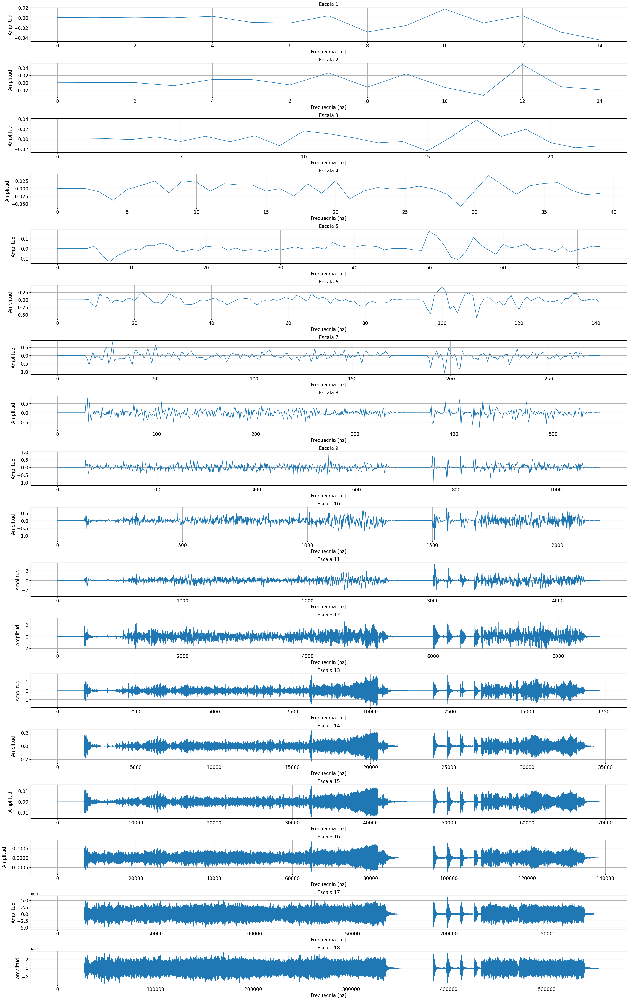

In [40]:
plt.figure(figsize=(30,50))


for i in range(len(coeffs_filtered)):
    
    plt.subplot(len(coeffs_filtered) + 1, 1, i + 2)
    plt.plot(np.arange(len(coeffs_filtered[i])), coeffs_filtered[i])
    plt.title('Escala {}'.format(i + 1), size=16)
    plt.xlabel('Frecuecnia [hz]', fontsize=16)
    plt.ylabel('Amplitud', fontsize=16)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid()
    

plt.tight_layout()
plt.show()

Las freceucnias de corte realizan una atenuación considerable en la señal, una vez esta pasa por el filtro. Ciertas escalas, en especial aquellas donde el tamaño de paso es superior o igual a 5KHz reflejan el efecto del filtro, llegando a amplitudes muchisimo más bajas si se comparan el espectro de la señal de audio antes de sewr afectada por el filtro.

## 6. Conclusiones

- El proceso por el cual se obtienen los coeficientes de la transformada de Wavelet representa una aplicación más de la teoria de filtros. Pues es necesario filtar la señal cada ciertos rangos de frecuencia e inmediatamente aplicar la vista pertinente a cada escala, con el objetivo de abaracar bajas y altas frecuancias sin excepción.

- La trasnformada discreta de Wavelet trata de abarcar la mayor cantidad de escalas posibles, llegando a tamaños de paso con altisimas frecuecnias, donde en la mayoria de casos no traen información relevante, basta con observar las amplitudes que se presentan en las últimas escalas de cada gráfica, en el que se tomen los coeficientes de la TDW. Esto se debe a las señales de audio con las que habitualmente se trabajan en estas guías de laboratorio.

- Tanto la transformada discreta de Fourier como la transformada discreta de Wavelet son herramientas bastante útiles a la hora de analizar señales en el dominio de la frecuencia, sin embargo la TDW presenta mayores ventajas cuando de detalles y minucisidad se trata, pues como se logro observar en la guía, a esacalas inferiores se logra ver un comportamineto más detallado de la señal a bajas frecuencias y conforme se analizan escalas superiores, un comportamiento más uniforme. Mientras que en la trasnformada discreta de Fourier, el comportamiento es uniforme de principio a fin, llegando apenas a identificar los rangos de frecuancia donde la señal tiene mayor influencia, y esto de una maneral muy generalizada.

- El alcanzar niveles de energia similares en los 3 métodos anteriores fue de suma importancia, pues 2 de los 3 métodos utilizados se estudiaron previamente en el curso. Un tercer método, por la TDW respalda los vistos en el curso y da a enteder que el concepto de la transformda discreta de Wavelet no esta lejos de los conceptos vistos durante el semestre y es perfectamente aplicable en el procesamiento de señales discretas.

- La transformada inversa de Wavelet no es ajena a la perdida de información con respecto al audio original. Es muy frecuente la pérdida de información en este tipo análisis, pues se realiza un descarte de componenetes de alta frecuencia, que en un principio parecen no ser relevantes.

- Como se comento en la guía, la frecuencia de corte para un filtro pasa bajas, como el que se trabajo en la guía, no anula  las frecuencias que se dan de ahí en adelante, las atenúa y este fenemeno es más evidente en ciertas escalas, como se observo anteriormente.

- Las diferentes escalas que se presentan en la transformada de Wavelet no modifican el espectro como tal, más bien modifican la manera en la que se observa el espectro.

